# **Programming Assessment \#5**

Names: <br>
Gonzales, Mark Edward M.<br>
Lee, Hylene Jules G.<br>
Ong, Phoebe Clare L.

More information on the assessment is found in our Canvas course. Link: https://dlsu.instructure.com/courses/93383/assignments/841058/

The following libraries and modules were used in this notebook.

In [1]:
import gensim
import random
import io
import numpy as np
import regex as re
from numpy.linalg import norm

The following constants are used to represent the word2vec, GloVe, and fastText models, as the user will provide an integer input corresponding to the chosen model.



In [2]:
WORD2VEC = 1
GLOVE = 2
FASTTEXT = 3
GLOVE_50D = 4
GLOVE_200D = 5

# **A. Load Pre-trained Embeddings**

*While you don't have to separate your code into blocks, it might be easier if you separated loading / downloading your data from the main part of your solution. Consider placing all loading of data into the code block below.*

The program uses sets of word embeddings pre-trained using three models: word2vec, GloVe, and fastText. A further discussion of the details of the selected word vectors can be found in the **Reflection section (Section C)** of this notebook.

### **1. word2vec**

Download the selected set of pre-trained word2vec word vectors. The binary file containing the data was uploaded to a Google Drive folder and is downloaded using the [`gdown`](https://pypi.org/project/gdown/3.3.1/) command.

In [3]:
!gdown 17uA0M0AXrhAVqFOBJDN33zIwjAsC2Ata

Downloading...
From: https://drive.google.com/uc?id=17uA0M0AXrhAVqFOBJDN33zIwjAsC2Ata
To: /content/GoogleNews-vectors-negative300.bin
100% 3.64G/3.64G [00:38<00:00, 95.4MB/s]


Load the downloaded word vectors into a model using Gensim's [`KeyedVectors`](https://radimrehurek.com/gensim/models/keyedvectors.html) module.

In [4]:
model_word2vec = gensim.models.KeyedVectors.load_word2vec_format('GoogleNews-vectors-negative300.bin', binary=True)  

### **2. GloVe**

Download pre-trained GloVe word vectors directly from the web.

In [5]:
!wget http://nlp.stanford.edu/data/glove.6B.zip

--2022-06-10 14:32:54--  http://nlp.stanford.edu/data/glove.6B.zip
Resolving nlp.stanford.edu (nlp.stanford.edu)... 171.64.67.140
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:80... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://nlp.stanford.edu/data/glove.6B.zip [following]
--2022-06-10 14:32:54--  https://nlp.stanford.edu/data/glove.6B.zip
Connecting to nlp.stanford.edu (nlp.stanford.edu)|171.64.67.140|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: http://downloads.cs.stanford.edu/nlp/data/glove.6B.zip [following]
--2022-06-10 14:32:54--  http://downloads.cs.stanford.edu/nlp/data/glove.6B.zip
Resolving downloads.cs.stanford.edu (downloads.cs.stanford.edu)... 171.64.64.22
Connecting to downloads.cs.stanford.edu (downloads.cs.stanford.edu)|171.64.64.22|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 862182613 (822M) [application/zip]
Saving to: ‘glove.6B.zip’

glove.6

Unzip the downloaded zipped folder to extract the word vectors.

In [6]:
!unzip glove.6B.zip

Archive:  glove.6B.zip
  inflating: glove.6B.50d.txt        
  inflating: glove.6B.100d.txt       
  inflating: glove.6B.200d.txt       
  inflating: glove.6B.300d.txt       


Load the downloaded word vectors into a dictionary to serve as the model.

In [7]:
model_glove = {}

glove_file = open('glove.6B.100d.txt', encoding='utf-8')

# For each line in the file, representing a single word vector, store the word itself as the key of the dictionary and 
# the values of its corresponding word vector as the values of the dictionary.
for line in glove_file:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    model_glove[word] = coefs
    
glove_file.close()

### **3. fastText**

Download the selected set of pre-trained fastText word vectors. The vector file containing the data was uploaded onto a Google Drive folder and is downloaded using the [`gdown`](https://pypi.org/project/gdown/3.3.1/) command.

In [8]:
!gdown 15id7DgjYOuPSGdt_xSp6qquRf9R4JK1m

Downloading...
From: https://drive.google.com/uc?id=15id7DgjYOuPSGdt_xSp6qquRf9R4JK1m
To: /content/wiki-news-300d-1M-subword.vec
100% 2.26G/2.26G [00:19<00:00, 116MB/s]


Load the downloaded word vectors into a dictionary to serve as the model.

In [9]:
model_fasttext = {}

fasttext_file = io.open('wiki-news-300d-1M-subword.vec', 'r', encoding = 'utf-8', newline = '\n', errors = 'ignore')

# For each line in the file, representing a single word vector, store the word itself as the key of the dictionary and 
# the values of its corresponding word vector as the values of the dictionary.
for line in fasttext_file:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    model_fasttext[word] = coefs

Examine the keys of the loaded dictionary.

In [10]:
model_fasttext.keys()

dict_keys(['999994', ',', 'the', '.', 'and', 'of', 'to', 'in', 'a', '"', ':', ')', 'that', '(', 'is', 'for', 'on', '*', 'with', 'as', 'it', 'The', 'or', 'was', "'", "'s", 'by', 'from', 'at', 'I', 'this', 'you', '/', 'are', '=', 'not', '-', 'have', '?', 'be', 'which', ';', 'all', 'his', 'has', 'one', 'their', 'about', 'but', 'an', '|', 'said', 'more', 'page', 'he', 'your', 'will', 'its', 'so', 'were', 'had', 'also', 'only', 'if', 'time', 'some', 'people', 'like', 'who', 'them', 'other', 'they', 'when', 'Wikipedia', 'article', 'what', '#', 'just', '!', 'any', 'after', 'there', 'would', 'can', 'In', 'her', 'talk', 'use', 'then', 'into', 'up', '...', 'we', 'over', 'my', 'out', 'here', 'now', 'because', 'do', 'work', 'than', 'no', 'UTC', 'me', 'A', 'two', 'our', 'been', 'new', 'where', '–', 'first', 'such', 'made', '--', 'If', "'t", 'both', 'before', 'way', '1', 'through', 'information', 'him', 'being', 'many', 'most', 'But', 'those', 'while', 'name', 'This', 'should', 'how', 'even', 'these

Pop the key corresponding to the first line of the file, as it indicates the number of words and dimensions rather than an actual word vector.

In [11]:
model_fasttext.pop('999994')

array([300.], dtype=float32)

# **B. Your Implementation**

*Again, you don't have to have everything in one block. Use the notebook according to your preferences with the goal of fulfilling the assessment in mind.*

### **1. Semantle Word List**

The random words generated for the Semantle replication are chosen from a list of simple English words. This list has been uploaded onto a Google Drive folder and is downloaded using the [`gdown`](https://pypi.org/project/gdown/3.3.1/) command.

In [12]:
!gdown 1644v0JelHNcnvsZZPUbmn3YmHNnoWCk1

Downloading...
From: https://drive.google.com/uc?id=1644v0JelHNcnvsZZPUbmn3YmHNnoWCk1
To: /content/words.txt
100% 4.86M/4.86M [00:00<00:00, 24.8MB/s]


Open the downloaded text file and store them in a list.

In [13]:
word_list_file = open('words.txt', 'r')
word_list = word_list_file.read().split('\n')

Remove words from the list that contain numerical characters or punctuation marks to simplify the user's guesses.

In [14]:
symbols_to_remove = r'[\W0-9]'

Construct a new list without the removed words.

In [15]:
clean_list = []

for i in range(len(word_list)):
  remove_word = re.search(symbols_to_remove, word_list[i])
  
  if (remove_word == None):
    clean_list.append(word_list[i])

The exclusion of words with numerical characters or punctuation marks removed over 50000 words from the original list.

In [16]:
len(word_list) - len(clean_list)

50254

This function chooses a random word from the clean word list depending on the word embedding model chosen by the user.

**Parameters**
- `model_type` (int): The integer value corresponding to the model chosen by the user

**Return Value**
-  String: Random word from the clean word list

In [17]:
def get_word(model_type):
  # Get a random word from the clean word list.
  word = random.choice(clean_list)
  
  # Check whether the selected word is in the model chosen by the user. If not, keep getting words from the clean word list
  # until the selected word is in the chosen model.
  if (model_type == WORD2VEC):
    while (not word in model_word2vec.vocab):
      word = random.choice(clean_list)
  
  elif (model_type == GLOVE):
    while (not word in model_glove.keys()):
      word = random.choice(clean_list)
  
  else:
    while (not word in model_fasttext.keys()):
      word = random.choice(clean_list)

  return word

### **2. Similarity Scores**

This function computes for the cosine similarity between two words

**Parameters**
- `str1` (string): The first word
- `str2` (string): The second word

**Return Value**
-  Float: Cosine similarity between the first word and the second word

In [18]:
def get_cosine_similarity(str1, str2):
  return np.dot(str1, str2)/(norm(str1)*norm(str2))

This function computes for the cosine similarity between the target word and all the other words in the chosen model.

**Paramters**
- `model_type` (int): The integer value corresponding to the model chosen by the user
- `target_word` (string): The target word to be guessed

**Return Value**
- Dictionary: Contains all the computed cosine similarities between the target word and all the other words in the chosen model

In [19]:
def get_target_word_similarity_scores(model_type, target_word):
  # Get the list of words of the selected model.
  if model_type == WORD2VEC:
    model = model_word2vec
    vocab = model.vocab
      
  elif model_type == GLOVE:
    model = model_glove
    vocab = model.keys()
  
  elif model_type == FASTTEXT:
    model = model_fasttext
    vocab = model.keys()

  # The following two models are not included in the scope of the implementation; they are used for the experiments
  # conducted in Section 3.B of the reflection.
  elif model_type == GLOVE_50D:
    model = model_glove_50d
    vocab = model.keys()

  else:
    model = model_glove_200d
    vocab = model.keys()

  # Compute for the cosine similarity between the target word and all other words in the model.
  word_similarity = {}
  for key in vocab:
    word_similarity[key] = get_cosine_similarity(model[key], model[target_word])
    
  return word_similarity

This function displays the baseline similarity scores close to the target word.

**Parameters**
- `baseline_position` (list): List of positions of the similarity scores of the words to be displayed
- `word_similarity` (dict): List of cosine similarities between the target word and all the other words in the model

In [20]:
def display_baseline_similarity_scores(baseline_position, word_similarity):
  # Sort the words in the model according to their cosine similarity to the target word in descending order.
  sorted_word_similarity = sorted(word_similarity.items(), key=lambda x: x[1], reverse=True)
  
  # Append the appropriate ordinal suffixes to the words in the model.
  for i in baseline_position:
    if (i % 10 == 1):
      ordinal = "st"
    elif (i % 10 == 2):
      ordinal = "nd"
    elif (i % 10 == 3):
      ordinal = "rd"
    else:
      ordinal = "th"

    print(str(i) + ordinal + ": " + sorted_word_similarity[i][0] + " " + str(sorted_word_similarity[i][1]))

### **3. Semantle Replication**

This function lets the user guess any random word in the chosen model and displays the similarity between the guessed word and the random word until the user guesses the word correctly.

**Paramaters**
- `model_type` (int): The integer value corresponding to the model chosen by the user.

In [21]:
def get_semantle(model_type):
  # Get the target word and model according to the user's selection.
  target_word = get_word(model_type)

  if model_type == WORD2VEC:
    model = model_word2vec
  elif model_type == GLOVE:
    model = model_glove
  else:
    model = model_fasttext

  # Display the target word and some of the semantically closest words.
  print("\nRandomly selected word: " + target_word)

  print("\nClosest...")

  # Computes for the cosine similarity between target word and all other words vectors in the chosen model.
  similarity_scores = get_target_word_similarity_scores(model_type, target_word)

  # Displays the baseline similarity scores to the target word of the 10th, 50th, and 100th semantically
  # closest words.
  baseline_position = [10, 50, 100]
  display_baseline_similarity_scores(baseline_position, similarity_scores)

  guess = ""
  while guess != target_word: 
    # Get the user input. Only one word is allowed.
    wrong_input = True
    while wrong_input == True: 
      guess = input("\nYour guess: ")
      if (len(guess.split()) > 1):
          print("Please enter only one word.")
      else:
        wrong_input = False
    
    # Get the similarity score between the user's guess and the target word.
    if guess in model:
      if guess == target_word:
        similarity = 1.0
      else:
        similarity = similarity_scores[guess]
      print(guess + " : " + str(similarity))
    else:
      # If the user's guess is not in the vocabulary of the chosen model, display the appropriate message.
      print("Word not recognized in resource.")

  # End the program when the user guesses the target word.
  print("\nGreat job on guessing the word!")

### **4. Main Program**

In [22]:
# Get the chosen model from the user.
model_type = 0
while model_type != '1' and model_type != '2' and model_type != '3':
  print("\nChoose the model you want to guess from: ")
  print("(1) word2vec")
  print("(2) GloVe")
  print("(3) fastText")
  model_type = input("Input your answer: ")

  if (model_type != '1' and model_type != '2' and model_type != '3'):
    print("Kindly input 1, 2, or 3 only")

# Perform the Semantle replication according to the user's chosen model.
get_semantle(int(model_type))


Choose the model you want to guess from: 
(1) word2vec
(2) GloVe
(3) fastText
Input your answer: 2

Randomly selected word: meringue

Closest...
10th: applesauce 0.62070745
50th: sprinkle 0.53942055
100th: sprinkling 0.49639466

Your guess: food
food : 0.02814785

Your guess: apple
apple : 0.23625518

Your guess: NLP1000
Word not recognized in resource.

Your guess: ganache
ganache : 0.5966241

Your guess: applesauce
applesauce : 0.62070745

Your guess: meringue
meringue : 1.0

Great job on guessing the word!


# **C. Your Reflection / Takeaway / Analysis**

*Kindly place the rest of your write up. More information is found in the Canvas write up.*

## **1. Implementation Details**

The notebook makes use of three pre-trained word embeddings: Google's word2vec, Stanford's GloVe, and Facebook AI Research Lab's fastText. In this Semantle replication, users can choose which word embedding for the computation of the similarity scores.

### **a. Word Embeddings**

***Embedding #1: word2vec***



Developed by [Mikolov, Sutskever et al. (2013)](https://proceedings.neurips.cc/paper/2013/file/9aa42b31882ec039965f3c4923ce901b-Paper.pdf), the word2vec model initially used a skip-gram neural network model to quickly learn word vector representations and predict the words near it. The developers added several extensions to the skip-gram base to improve vector quality and training speed, including the use of the more computationally efficient hierarchical softmax function or negative sampling to approximate the full softmax activation function and subsampling frequently occurring words to minimize training time. A salient characteristic of the word2vec model is the additive compositionality of its word vectors; adding word vectors element-wise results in meaningful combinations of words that can semantically represent the concatenation of words as a single phrase. As an extension, word phrases can also be represented using a single word vector. Currently, word2vec embeddings can be pre-trained using either the skip-gram or the continuous bag of words (CBOW) architecture.

The pre-trained word2vec model was trained on about 3 million words and phrases taken from the Google News dataset ([Google, 2013](https://code.google.com/archive/p/word2vec/)); the selected words were represented as 300-dimensional vectors. The words in the model can be inspected by calling the `vocab` property of the Gensim `KeyedVectors` object.

In [23]:
model_word2vec.vocab

{'</s>': <gensim.models.keyedvectors.Vocab at 0x7fda02c2df90>,
 'in': <gensim.models.keyedvectors.Vocab at 0x7fda01c321d0>,
 'for': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3c50>,
 'that': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3ad0>,
 'is': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3a50>,
 'on': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3e10>,
 '##': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3b50>,
 'The': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3390>,
 'with': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3f50>,
 'said': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3a10>,
 'was': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3090>,
 'the': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3190>,
 'at': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3f90>,
 'not': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3990>,
 'as': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3ed0>,
 'it': <gensim.models.keyedvectors.Vocab at 0x7fd9ff2a3f10>,
 'be': <gen

As highlighted in an analysis of the dataset by [McCormick (2016)](https://mccormickml.com/2016/04/12/googles-pretrained-word2vec-model-in-python/), the word2vec model contains several stop words, such as common articles and prepositions. It also contains some misspellings and case-sensitive duplicates of some words. Some strings of the form `###`, where the pound symbols are interpreted as placeholders for any numerical characters, and groups of commonly paired words separated by an underscore, like `New_York`, are also included.
 
The embedding was pre-trained using the CBOW architecture, subsampling at a threshold of 10<sup>&ndash;5</sup> and negative sampling with 3 negative examples for each positive word, and a window size (i.e., the maximum distance between the current and predicted words) of 5 ([Mikolov, 2013](https://groups.google.com/g/word2vec-toolkit/c/lxbl_MB29Ic/m/NDLGId3KPNEJ)). The pre-trained embedding was loaded using the `models.word2vec` module of the Gensim API. By default, the module loads the dataset using `utf8` encodings and 32-bit floating point representations of the vector dimensions ([Řehůřek, 2022](https://radimrehurek.com/gensim/models/keyedvectors.html#gensim.models.keyedvectors.KeyedVectors.load_word2vec_format)). Loading the model through the Gensim API minimizes its memory requirement by removing the binary tree, preventing further training of the model. No further modifications to the model were made after loading.

***Embedding #2: GloVe***

The GloVe or Global Vector embedding, developed by [Pennington, Socher, and Manning (2014)](https://aclanthology.org/D14-1162.pdf), is a global log-bilinear regression model that combines two types of methods for learning word vectors: global matrix factorization methods and local context window methods. Global matrix factorization methods are able to efficiently use statistical representations of data by representing large matrices as low-rank approximations, but have suboptimal vector space structures, causing them to perform poorly on word analogy tasks. On the other hand, local context window methods, which use other words within the specified window to inform the prediction of the target word, perform well on word analogies but are unable to maximize the statistical characteristics of the data as a whole as they do not examine the global trends of the corpus. The GloVe embedding combines the strengths of these two classes of methods by creating a weighted least squares model trained on global co-occurrence counts, and has been noted to perform better than other models on word analogy, word similarity, and named entity recognition tasks.

The pre-trained GloVe model was trained on the publicly available `glove.6B` text file, which contains six billion tokens with a vocabulary of 400 thousand words taken from Wikipedia 2014 and Gigaword 5 ([Pennington, Socher, and Manning, n.d.](https://nlp.stanford.edu/projects/glove/)). The 100-dimensional vector representations of the data was used for the model. The words in the model can be inspected by calling the `keys()` method.

In [24]:
model_glove.keys()

dict_keys(['the', ',', '.', 'of', 'to', 'and', 'in', 'a', '"', "'s", 'for', '-', 'that', 'on', 'is', 'was', 'said', 'with', 'he', 'as', 'it', 'by', 'at', '(', ')', 'from', 'his', "''", '``', 'an', 'be', 'has', 'are', 'have', 'but', 'were', 'not', 'this', 'who', 'they', 'had', 'i', 'which', 'will', 'their', ':', 'or', 'its', 'one', 'after', 'new', 'been', 'also', 'we', 'would', 'two', 'more', "'", 'first', 'about', 'up', 'when', 'year', 'there', 'all', '--', 'out', 'she', 'other', 'people', "n't", 'her', 'percent', 'than', 'over', 'into', 'last', 'some', 'government', 'time', '$', 'you', 'years', 'if', 'no', 'world', 'can', 'three', 'do', ';', 'president', 'only', 'state', 'million', 'could', 'us', 'most', '_', 'against', 'u.s.', 'so', 'them', 'what', 'him', 'united', 'during', 'before', 'may', 'since', 'many', 'while', 'where', 'states', 'because', 'now', 'city', 'made', 'like', 'between', 'did', 'just', 'national', 'day', 'country', 'under', 'such', 'second', 'then', 'company', 'group

As can be seen in the subset of displayed keys, the words in the model are all in lowercase. However, stop words such as prepositions and articles are included, as well as punctuation marks, the suffix portions of contractions, and proper nouns. Moreover, some non-English words and numbers or words with numerical characters are also included.

As noted in GloVe's documentation ([Pennington et al., n.d.](https://nlp.stanford.edu/projects/glove/)), the model was pre-trained on the nonzero entries of a global word-word co-occurrence matrix with a weighted least squares objective. The model was loaded using `utf8` encodings and 32-bit floating point representations of the vector dimensions. As the model was provided as a text file, its contents were loaded onto a dictionary, with the first string of each line representing the word and the succeeding strings of the line representing its vector dimensions. No further modifications to the model were made after loading.

***Embedding #3: fastText***

The development of the subword model was motivated by improving the morphological representations of existing word representation techniques, notably the popular word2vec model ([Bojanowski et al., 2017](https://aclanthology.org/Q17-1010.pdf)). Rather than representing individual words, representations for character $n$-grams were instead learned by the model, and words were represented as sums of multiple $n$-gram vectors. This subword model was built upon the continuous skip-gram model developed by [Mikolov, Corrado et al. (2013)](https://arxiv.org/pdf/1301.3781.pdf). Apart from the added morphological representations, the model is also notable for having a fast training time and requiring no preprocessing or supervision. Later on, this subword model was incorporated into the fastText embedding developed by [Joulin et al. (2017)](https://aclanthology.org/E17-2068.pdf); the model compressed the n-gram subword vectors using the hashing trick and made use of hierarchical softmax to minimize its training time. In addition to its speed, the fastText model notably attained performance values on par with several deep learning models for tag prediction and sentiment analysis tasks.

The pre-trained fastText model was trained on a set of roughly one million word vectors with 16 billion tokens ([Facebook Inc., n.d.](https://fasttext.cc/docs/en/english-vectors.html)). This data was taken from Wikipedia 2017, the UMBC webbase corpus, and the statmt.org news dataset. Additionally, pre-training was performed with subword information. The words in the model can be inspected by calling the `keys()` method.

In [25]:
model_fasttext.keys()

dict_keys([',', 'the', '.', 'and', 'of', 'to', 'in', 'a', '"', ':', ')', 'that', '(', 'is', 'for', 'on', '*', 'with', 'as', 'it', 'The', 'or', 'was', "'", "'s", 'by', 'from', 'at', 'I', 'this', 'you', '/', 'are', '=', 'not', '-', 'have', '?', 'be', 'which', ';', 'all', 'his', 'has', 'one', 'their', 'about', 'but', 'an', '|', 'said', 'more', 'page', 'he', 'your', 'will', 'its', 'so', 'were', 'had', 'also', 'only', 'if', 'time', 'some', 'people', 'like', 'who', 'them', 'other', 'they', 'when', 'Wikipedia', 'article', 'what', '#', 'just', '!', 'any', 'after', 'there', 'would', 'can', 'In', 'her', 'talk', 'use', 'then', 'into', 'up', '...', 'we', 'over', 'my', 'out', 'here', 'now', 'because', 'do', 'work', 'than', 'no', 'UTC', 'me', 'A', 'two', 'our', 'been', 'new', 'where', '–', 'first', 'such', 'made', '--', 'If', "'t", 'both', 'before', 'way', '1', 'through', 'information', 'him', 'being', 'many', 'most', 'But', 'those', 'while', 'name', 'This', 'should', 'how', 'even', 'these', 'see', 

As can be seen in the subset of displayed keys, the model contains both lowercase and uppercase words, as well as stop words, punctuation marks, and the suffix portions of contractions. Some misspellings, such as "catagorization", are also included, as well as non-English words and words written in different alphabets. 

As previously mentioned, the model pre-training involved creating a hashed representation of character $n$-grams and the use of hierarchical softmax ([Facebook Inc., n.d.](https://fasttext.cc/docs/en/english-vectors.html)). The model was loaded using UTF-8 encodings and 32-bit floating point representations of the vector dimensions. The contents of the model were loaded onto a dictionary, with the first string of each line representing the word and the succeeding strings of the line representing its vector dimensions. However, as it was originally provided as a vector file, the first line contained the number of instances and dimensions of the model, which was removed from the dictionary after loading.

## **b. Simple English Word List**

To avoid generating random words that contain anomalies such as punctuation marks or misspellings, as well as to ensure that all generated words would be English words, the random words were generated from a publicly available list of over 466 thousand simple English words ([Infochimps, 2011](https://web.archive.org/web/20131118073324/http://www.infochimps.com/datasets/word-list-350000-simple-english-words-excel-readable)); to optimize the loading of the data, a text file containing the word list available on GitHub ([Nelsonic, 2022](https://github.com/dwyl/english-words)) was used in the notebook. Words with punctuation marks or numerical characters were then removed from the list to decrease the scope of the user's guesses.

Some of the words in the final list can be inspected by calling the variable assigned to the clean list.

In [26]:
clean_list

['a',
 'AA',
 'AAA',
 'AAAA',
 'AAAAAA',
 'AAAL',
 'AAAS',
 'Aaberg',
 'Aachen',
 'AAE',
 'AAEE',
 'AAF',
 'AAG',
 'aah',
 'aahed',
 'aahing',
 'aahs',
 'AAII',
 'aal',
 'Aalborg',
 'Aalesund',
 'aalii',
 'aaliis',
 'aals',
 'Aalst',
 'Aalto',
 'AAM',
 'AAMSI',
 'Aandahl',
 'Aani',
 'AAO',
 'AAP',
 'AAPSS',
 'Aaqbiye',
 'Aar',
 'Aara',
 'Aarau',
 'AARC',
 'aardvark',
 'aardvarks',
 'aardwolf',
 'aardwolves',
 'Aaren',
 'Aargau',
 'aargh',
 'Aarhus',
 'Aarika',
 'Aaron',
 'Aaronic',
 'Aaronical',
 'Aaronite',
 'Aaronitic',
 'Aaronsburg',
 'Aaronson',
 'AARP',
 'aarrgh',
 'aarrghh',
 'Aaru',
 'AAS',
 'aasvogel',
 'aasvogels',
 'AAU',
 'AAUP',
 'AAUW',
 'AAVSO',
 'AAX',
 'AB',
 'ABA',
 'Ababa',
 'Ababdeh',
 'Ababua',
 'abac',
 'abaca',
 'abacay',
 'abacas',
 'abacate',
 'abacaxi',
 'abaci',
 'abacinate',
 'abacination',
 'abacisci',
 'abaciscus',
 'abacist',
 'aback',
 'abacli',
 'Abaco',
 'abacot',
 'abacterial',
 'abactinal',
 'abactinally',
 'abaction',
 'abactor',
 'abaculi',
 'abacul

Based on the subset of words displayed, the clean list contains both lowercase and uppercase words. However, compared to the word embeddings, it no longer contains numerical character or punctuation marks.

To generate the random word to be guessed by the user, a random word is first chosen from the prepared word list. This word is then checked against the user's chosen model; if the word is not in the chosen model, new random words are chosen until a word present in the chosen model is generated. Since no further data processing was performed on the pre-trained embeddings, limiting the words to be guessed to those present in the word list prevents the generation of misspelled and non-English words, which may widen the scope of this Semantle replication excessively and make it difficult for the user to arrive at the correct answer.

## **c. Cosine Similarity**

The pairwise word similarities are computed by getting the cosine similarities of their respective word vectors. The cosine similarity, which is computed by dividing the dot product of two vectors over the product of their respective magnitudes, measures the cosine of the angle between the two vectors, as highlighted in Figure 1. This normalization strategy avoids the excessive favoring of frequent words (i.e., long vectors) that occurs when only the dot product is used to represent word similarities. Moreover, with its range of [&ndash;1, 1], cosine similarity is also able to represent the directions of the vectors: vectors close to &ndash;1 point in opposite directions, those close to 1 point in the same direction, and vectors with a cosine similarity of 0 are orthogonal. (As seen in the experiments, negative cosine similarities are possible when using GloVe due to its embedding scheme; this is corroborated by [Ghatak [2019]](https://books.google.com.ph/books?id=QlmSDwAAQBAJ&printsec=frontcover#v=onepage&q&f=false).)

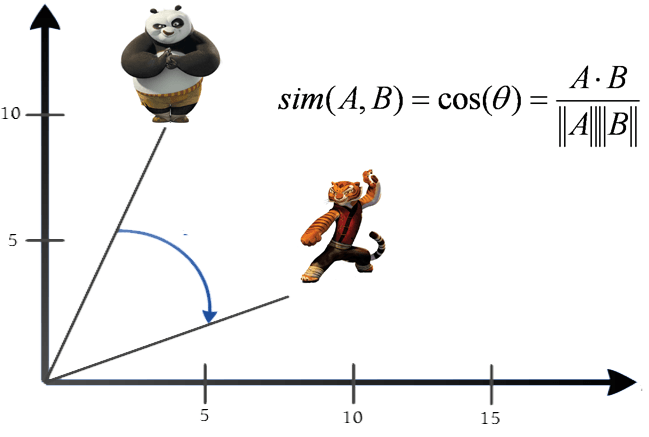

**Figure 1.** Visual representation of cosine similarity. Photo from https://miro.medium.com/max/697/0*XMW5mf81LSHodnTi.png (edited)

## **d. Final Algorithm**

Let $m$ be the word embedding model chosen by the user, $𝑊$ be the set of words in the chosen model, $x$ be the target word to be guessed by the user, and $y$ be the current word guessed by the user. The flow of the algorithm is as follows:

1. Get the chosen model $m$ from the user input.
2. Generate a random word $x$ from the set of words $W$ in model $m$.
3. For each word $w$ in $W$, compute for the cosine similarity $\cos \theta$ between $w$ and $x$.
4. Sort the words in $W$ in descending order of $\cos \theta$.
5. Display $x$ and the 10<sup>th</sup>, 50<sup>th</sup>, and 100<sup>th</sup> words most semantically similar to $x$.
6. While $y$ is not equal to $x$:
> 1.   Get the guessed word $y$ from the user input.
> 2.   If $y$ is in $W$:
>> 1. If $y$ is equal to $x$, display a cosine similarity of 1.0 and a message indicating the user has guessed the word.
>> 2. Otherwise, display the cosine similarity between $y$ and $x$.
> 3. Otherwise, display an error message stating that $y$ is not in $W$.
7. Once the user has guessed the correct word $x$, the program terminates.






### **2. Model Selection and Word Similarities**

To provide a cursory comparison of the effect of using different models and dimensions on the produced similarity scores, the similarities of the words in the examined embeddings on the word `mushroom` are calculated. The 100 most similar words are printed to explore trends in the word vectors.

In [27]:
target_word = 'mushroom'
similarity_ranks = list(range(1, 101))

## **a. Word Similarities Across Different Models**

The differences in word similarities across the three pre-trained embeddings are qualitatively examined. For each model, the `get_target_word_similarity_scores()` function is used to compute the similarity scores between the target word and all other words in the model, and the `display_baseline_similarity_scores()` function is used to display the 100 most similar words.

***word2vec Word Similarities.*** First, the most similar words in the word2vec model are obtained.

In [28]:
similarity_scores_word2vec = get_target_word_similarity_scores(WORD2VEC, target_word)

In [29]:
display_baseline_similarity_scores(similarity_ranks, similarity_scores_word2vec)

1st: mushrooms 0.7716439
2nd: chanterelle 0.610329
3rd: wild_mushrooms 0.6075052
4th: oyster_mushrooms 0.58858055
5th: morels 0.5848848
6th: matsutake 0.5761628
7th: amanita 0.5729077
8th: edible_mushrooms 0.5721446
9th: morel 0.5710611
10th: Mushroom 0.5663895
11st: edible_fungi 0.5655549
12nd: blueberry 0.5633725
13rd: wild_mushroom 0.5630325
14th: shroom 0.5622987
15th: morel_mushroom 0.56211966
16th: shiitake 0.56182796
17th: shiitake_mushroom 0.5610316
18th: boletes 0.5514695
19th: bolete 0.54610574
20th: oyster_mushroom 0.5442083
21st: enoki 0.54064
22nd: morel_mushrooms 0.53977484
23rd: potato 0.53806734
24th: maitake_mushrooms 0.53328973
25th: Amanita_phalloides 0.53279513
26th: shitake 0.5326456
27th: tomato 0.5321824
28th: chanterelles 0.5317694
29th: porcinis 0.52953166
30th: edible_mushroom 0.52936435
31st: boletus 0.5292659
32nd: Mushrooms 0.5288854
33rd: enoki_mushrooms 0.5272904
34th: dandelion 0.5253523
35th: asparagus 0.5241075
36th: angel_trumpet 0.5199873
37th: straw

As the word2vec model distinguishes between uppercase and lowercase words, this leads to what may arguably be semantic duplicates in the data; the word `Mushroom`, in uppercase, is reported to be the 10<sup>th</sup> most similar word to `mushroom`, while the word `mushrooms` is the first most similar word and its uppercase version `Mushrooms` is the 32<sup>nd</sup>. Moreover, as the model contains phrases in addition to single words, some of its most similar words are also specific terms, such as particular species of mushrooms and even some species of other plants like tomato, peas, flowers, and buckwheat. 

Majority of the most similar words can be regarded as located in a fairly narrow context of the target word, in that these most of these words appear to "interpret" the word `mushroom` as an ingredient for cooking. This narrow context may be due to the model's use of the CBOW architecture, which effectively limits its comparisons to a specified window size. Additionally, compared to skip-gram implementations, CBOW is noted to produce higher syntactic over semantic accuracy ([Mikolov, Corrado et al., 2013](https://arxiv.org/pdf/1301.3781.pdf)). This is evidenced in the inclusion of the word `mushroom` in many of the most similar words as well as the focus on particular mushroom species over other plants which may have similar culinary usage to mushrooms.

***GloVe Word Similarities.*** Next, the most similar words in the GloVe model are obtained.

In [30]:
similarity_scores_glove = get_target_word_similarity_scores(GLOVE, target_word)

In [31]:
display_baseline_similarity_scores(similarity_ranks, similarity_scores_glove)

1st: mushrooms 0.72603875
2nd: tomato 0.6131451
3rd: shiitake 0.61311173
4th: truffle 0.5931091
5th: onion 0.58950496
6th: fungus 0.56165457
7th: porcini 0.5549275
8th: potato 0.55433685
9th: agaric 0.5465089
10th: mustard 0.54605925
11st: oyster 0.54604596
12nd: sausage 0.54252416
13rd: edible 0.54207754
14th: lobster 0.53297985
15th: risotto 0.53291005
16th: fruit 0.5304941
17th: truffles 0.52993256
18th: amanita 0.5284555
19th: pumpkin 0.5272037
20th: crab 0.5261684
21st: ravioli 0.5242703
22nd: cucumber 0.5220274
23rd: orchid 0.52186954
24th: shrimp 0.5193062
25th: egg 0.5192368
26th: cheese 0.5166293
27th: watermelon 0.5146684
28th: custard 0.51392525
29th: honey 0.51275784
30th: onions 0.5127301
31st: chili 0.5110773
32nd: eggplant 0.5104591
33rd: soup 0.5101741
34th: basidiomycete 0.50963676
35th: spinach 0.50821686
36th: garlic 0.5077832
37th: poisonous 0.5065681
38th: chicken 0.50526375
39th: grape 0.5040875
40th: psilocybe 0.5031566
41st: cloud 0.5009193
42nd: sauce 0.5008905

Unlike the word2vec model, the GloVe model no longer contains phrases or words with capital letters. However, some of its most similar words are similar to those of the word2vec model, such as particular species of mushroom and vegetables commonly used for cooking.

Compared to the word2vec model, the GloVe model seems to consider a larger context for obtaining the most similar words. Apart from particular mushroom species and other vegetables, the most similar words from the GloVe model also include condiments, dishes, and animal products; in particular, the second most similar word is `tomato`, a farther semantic departure from the mushroom species comprising the first few most similar words in the word2vec model. Additionally, the GloVe model also returns some scientific words related to mushrooms, such as their genera (like `psilocybe` or `tricholoma`) or physical properties (like `gilled` or `woolly`). As the GloVe model examines global corpus co-occurrences rather than narrow word windows, this design may have caused the model to examine a broader context focused more on semantic rather than syntactic similarities.

***fastText Word Similarities.*** Lastly, the most similar words in the fastText model are obtained.

In [32]:
similarity_scores_fasttext = get_target_word_similarity_scores(FASTTEXT, target_word)

In [33]:
display_baseline_similarity_scores(similarity_ranks, similarity_scores_fasttext)

1st: mushrooms 0.842144
2nd: shroom 0.7213093
3rd: mushroom-shaped 0.70445603
4th: mushroomy 0.70391446
5th: mushroom-like 0.69469637
6th: mushrooming 0.6532929
7th: shiitake 0.6478707
8th: Mushroom 0.64335465
9th: fungus 0.63347733
10th: Mushrooms 0.6227725
11st: shrooms 0.6206031
12nd: toadstool 0.6144826
13rd: truffle 0.6139677
14th: puffball 0.6105783
15th: polypore 0.593284
16th: agaric 0.59163
17th: starfruit 0.5909178
18th: psilocybe 0.5900196
19th: shitake 0.5900064
20th: hallucinogenic 0.58715355
21st: funghi 0.5871498
22nd: potpie 0.58605474
23rd: spore 0.58466494
24th: bolete 0.5835376
25th: stinkhorn 0.5805968
26th: mycology 0.57981634
27th: dragonfruit 0.57945603
28th: psilocybin 0.5712123
29th: fungo 0.57071906
30th: maitake 0.5697424
31st: baneberry 0.567994
32nd: reishi 0.5676416
33rd: morel 0.5673585
34th: toadstools 0.56636727
35th: mushies 0.56467354
36th: herb 0.5639616
37th: Psilocybe 0.5636205
38th: Psilocybin 0.5628655
39th: cassata 0.56277853
40th: mycological 0

Similar to the word2vec model, the fastText model differentiates between uppercase and lowercase words. Moreover, several of the most similar words obtained using the fastText model are hyphenated, something which was not observed in the first two models.

Compared to the first two models, the fastText model seems to consider the narrowest context, as it has the most number of similar words that refer to particular types of mushrooms. For the similar words outside of this category, they also appear to be limited to other plants or chemical properties of mushrooms. These results may be caused by the use of subwords in the pre-training of the fastText model, which causes it to focus on the morphological similarities between words; hence, the first few most similar words also contain `mushroom`.

## **b. Word Similarities Across Different Dimensions**

The differences in word similarities across word vectors with different dimensions are also cursorily examined. The 50- and 200-dimension word vectors for the GloVe model are loaded, and the similarity scores and 100 most similar words to the word `mushroom` are also displayed. These results are compared to those of the 100-dimension word embedding for the GloVe model that was used in the implementation.

***50-dimension Embedding Word Similarities.*** The pre-trained 50-dimension GloVe model is loaded into a dictionary. The 100 most similar words to the target word are then obtained and displayed.

In [34]:
model_glove_50d = {}

glove_file = open('glove.6B.50d.txt', encoding='utf-8')

# For each line in the file, representing a single word vector, store the word itself as the key of the dictionary and 
# the values of its corresponding word vector as the values of the dictionary.
for line in glove_file:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    model_glove_50d[word] = coefs
    
glove_file.close()

In [35]:
similarity_scores_glove_50d = get_target_word_similarity_scores(GLOVE_50D, target_word)

In [36]:
display_baseline_similarity_scores(similarity_ranks, similarity_scores_glove_50d)

1st: mushrooms 0.8183656
2nd: truffle 0.7565301
3rd: tomato 0.746178
4th: edible 0.73547053
5th: shiitake 0.7326658
6th: soup 0.730893
7th: crab 0.7296791
8th: oyster 0.715612
9th: roasted 0.7118675
10th: squid 0.7112269
11st: orchid 0.6999062
12nd: honey 0.69917494
13rd: poisonous 0.697871
14th: onion 0.6941025
15th: dried 0.6928939
16th: berries 0.69218117
17th: egg 0.6904526
18th: fruit 0.68442786
19th: seaweed 0.6825553
20th: meat 0.6817575
21st: eggs 0.6798424
22nd: lobster 0.6789967
23rd: shrimp 0.6786787
24th: pumpkin 0.6764275
25th: fish 0.67615575
26th: porcini 0.6740422
27th: tuna 0.6704358
28th: canned 0.67011195
29th: potato 0.6698847
30th: truffles 0.669145
31st: chicken 0.66872346
32nd: eaten 0.66845
33rd: chili 0.6681282
34th: fungus 0.6677282
35th: gilled 0.66678464
36th: algae 0.6659152
37th: marinated 0.66448253
38th: basidiomycete 0.65298057
39th: shellfish 0.65148413
40th: risotto 0.6474213
41st: paste 0.6471834
42nd: peppers 0.64666
43rd: goat 0.6460334
44th: conco

Compared to the 100-dimension GloVe model used in the Semantle replication, the first few most similar words of the 50-dimension model are fairly similar to those of the former. Both models also appeared to consider roughly the same context, as majority of the most similar words deal with species of mushrooms, scientific characteristics of mushrooms, and other edible ingredients.

However, especially near the end of the list, the context of the most similar words seems to become broader; apart from plant products, the list also contains several cooking methods and animals. The order of the list is also more "nebulous" compared to the original model, as particular terms related to mushrooms can be seen near the beginning of the list, at around the 35<sup>th</sup> rank, at the 56<sup>th</sup> rank, at the 64<sup>th</sup> rank, and at the 99<sup>th</sup> rank. Finally, the 50-dimension model returned higher similarity scores (from around 0.6031 to 0.8183) as compared to the 100-dimension model, whose scores ranged from about 0.4543 to 0.7260.

***200-dimension Embedding Word Similarities.*** Next, the pre-trained 200-dimension GloVe model is loaded into a dictionary, and its most similar words are computed and displayed.

In [37]:
model_glove_200d = {}

glove_file = open('glove.6B.200d.txt', encoding='utf-8')

# For each line in the file, representing a single word vector, store the word itself as the key of the dictionary and 
# the values of its corresponding word vector as the values of the dictionary.
for line in glove_file:
    values = line.split()
    word = values[0]
    coefs = np.asarray(values[1:], dtype='float32')
    model_glove_200d[word] = coefs
    
glove_file.close()

In [38]:
similarity_scores_glove_200d = get_target_word_similarity_scores(GLOVE_200D, target_word)

In [39]:
display_baseline_similarity_scores(similarity_ranks, similarity_scores_glove_200d)

1st: mushrooms 0.6935652
2nd: shiitake 0.5507041
3rd: tomato 0.5325844
4th: edible 0.5204815
5th: oyster 0.51884234
6th: porcini 0.51179343
7th: truffle 0.5076158
8th: basidiomycete 0.49199718
9th: risotto 0.4914538
10th: poisonous 0.47260255
11st: strophariaceae 0.4665687
12nd: soup 0.46512848
13rd: seaweed 0.46039474
14th: fungus 0.45716682
15th: spinach 0.45636588
16th: mustard 0.45609155
17th: cloud 0.45568648
18th: pumpkin 0.45035604
19th: ragout 0.449706
20th: truffles 0.44548714
21st: berries 0.44504473
22nd: gilled 0.44095132
23rd: ravioli 0.44019166
24th: psilocybe 0.43919542
25th: sauce 0.43820396
26th: fruit 0.43440434
27th: vegetable 0.4335738
28th: eggplant 0.43134207
29th: potato 0.42564347
30th: onion 0.42338246
31st: chanterelle 0.42159247
32nd: portobello 0.42030898
33rd: psilocybin 0.41919044
34th: shellfish 0.41733912
35th: cream 0.41473216
36th: clouds 0.414641
37th: lobster 0.4127238
38th: mixture 0.40920275
39th: agaric 0.4089123
40th: dumplings 0.40840086
41st: h

The first few most similar words of this model are similar to those of the other GloVe models as well, and majority of the words in the list are also either names of mushroom species, scientific characteristics of mushrooms, or food products, majority of which are plant-based.

Among the three GloVe models, the 200-dimension model seems to have the narrowest context, as it has fewer words that refer to animals or cooking methods. Moreover, the order of words seems to be more suggestive of distinct categories, as most of the terms related to mushrooms are gathered near the beginning of the list while the tail end is populated primarily by food-related terms. In terms of word similarity scores, this model returned the lowest scores among all three, with a range of about 0.3672 to 0.6935. 

### **3. Insights on Vector Semantics**

***Comparison to Semantle.*** As a replication of Semantle, it may be interesting to characterize the program's behavior in relation to Semantle. As stated in the Semantle FAQs ([Turner, n.d.](https://semantle.com/)), Semantle was implemented using a word2vec model trained on the 300-dimension Google News dataset, similar to the model used for this replication. However, there is some difference in the manner of generating the random word to be guessed, as [Turner (n.d.)](https://semantle.com/) notes that the word of the day is taken from a list of the 5000 most popular English words - though the dataset used was not provided - with capitalized words, hyphenated words, and word2vec stopwords removed.

A list of word similarities returned by Semantle is also produced to compare against this replication. Ten of the 1000 most similar words to the word of the day, as well as the answer itself, are retrieved using the "Hint" and "Give Up" options of Semantle. The data is shown in the following screenshot:

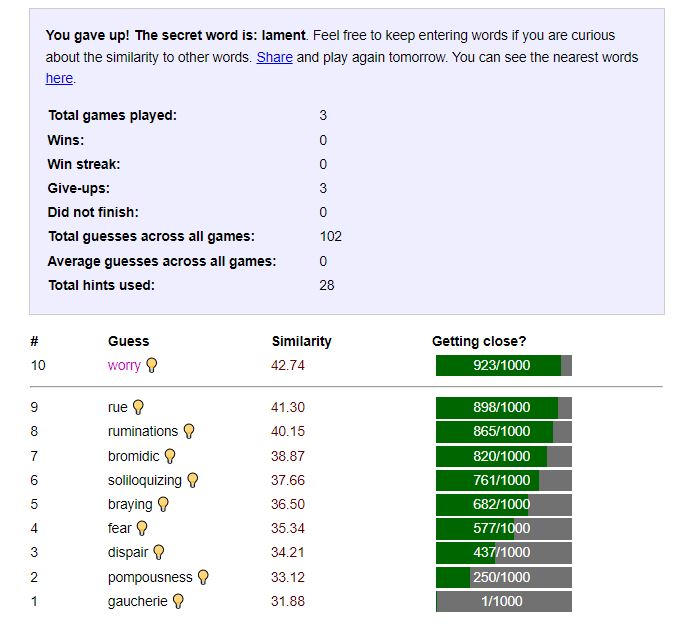

**Figure 2.** Results for Semantle puzzle number 132.

In comparison, the most similar words to the word `lament` with the same similarity indices are retrieved using the word2vec model loaded for this replication.

In [40]:
similarity_scores = get_target_word_similarity_scores(WORD2VEC, "lament")

In [41]:
# Due to the difference in notations used, the indices of the salient word similarities are computed as 
# 1000 - n, where n is the similarity index used in Semantle.
positions = [77, 102, 135, 180, 239, 318, 437, 563, 750, 999]
display_baseline_similarity_scores(positions, similarity_scores)

77th: mope 0.43522498
102nd: laud 0.42321602
135th: dismayed 0.4115362
180th: hymning 0.39905435
239th: blaming 0.38943487
318th: whinging 0.37974742
437th: castigating 0.36800006
563rd: despise 0.35825577
750th: Complain 0.34858757
999th: rhapsodising 0.33925924


Interestingly, none of the words in the equivalent similarity indices of this replication matched those returned by Semantle. For further investigation, the full list of the 1000 most similar words to the target word is displayed.

In [42]:
positions = similarity_ranks = list(range(1, 1001))
display_baseline_similarity_scores(positions, similarity_scores)

1st: bemoan 0.7799012
2nd: lamenting 0.73800486
3rd: bemoaning 0.6956246
4th: laments 0.6610704
5th: grumble 0.62134176
6th: bemoaned 0.6006222
7th: lamented 0.5937236
8th: lamentations 0.5906725
9th: bemoans 0.590658
10th: lamentation 0.5842768
11st: bewail 0.5825183
12nd: decry 0.5799239
13rd: bewailing 0.5594727
14th: moan 0.55645776
15th: complain 0.5353176
16th: mourn 0.5281055
17th: fret 0.5255861
18th: kvetch 0.5218601
19th: Sad 0.5191223
20th: whine 0.5190428
21st: grumbling 0.5112447
22nd: complain_bitterly 0.50734764
23rd: bleat 0.50192875
24th: yearn 0.5018425
25th: Lament 0.50130796
26th: weep 0.49725363
27th: cri_de_coeur 0.4882344
28th: sadly 0.48783296
29th: whinge 0.48605013
30th: moaning 0.48474818
31st: rejoice 0.47811943
32nd: fretting 0.47682682
33rd: wail 0.4767087
34th: decrying 0.4765903
35th: sad 0.47257796
36th: rejoicing 0.4721411
37th: elegies 0.4690371
38th: wax_poetic 0.46841565
39th: mourned 0.4676899
40th: Lamenting 0.4672685
41st: griping 0.46708724
42nd

While the full list of similar words contained the most similar words returned by Semantle, their similarity indices differed by around a factor of around 20. For instance, the word `worry` had a similarity index of 77 (converted to the notation used in this replication) in Semantle, but this replication returned a similarity index of 92. Similarly, the expected similarity index of the word `rue` is 102, but its actual index is 129. Based on the design notes in the Semantle FAQs ([Turner, n.d.](https://semantle.com/)), these differences in similarity indices may have been caused by the removal of capitalized words and phrases in the Semantle word2vec model. Since the similarity scores of the pertinent words were similar, only having been rounded off in Semantle, there appear to be no further differences in the model training for the Semantle model and the word2vec model used in this replication.

***Data and Design.*** As a natural language processing (NLP) task, it was expected that the quality and scope of the data fed to the models would greatly affect their outputs. However, a development choice that was particularly highlighted through this activity was the importance of model architecture on model performance. Even though the three pre-trained models used performed the same task, there were notable differences in their contexts and subsequent outputs. While the models were not pre-trained on the exact same dataset, their datasets were all taken from Wikipedia or news datasets; hence, it can be surmised that their data all followed a more informative tone, as opposed to the more casual register expected from less formal sources like social media sites or blog posts. 

Despite the similarities in data, the word2vec model appeared to have a narrower context and a greater focus on syntactical similarities, as opposed to the GloVe model which had a broader context and a greater focus on semantic similarities. Meanwhile, the fastText model was notable for its focus on morphological similarities; in relation to the previous assessment, the words returned by the fastText model had the closest minimum edit distances to the target word. The different foci of these three models highlighted the complexity of vector semantics; even within the scope of semantics, different models offer different "flavors" and linguistic biases, making certain models more fit for particular NLP tasks or domains.

Apart from model architecture, the representations of the word vectors also affected the model outputs. Based on the experiments on the three GloVe models, larger dimensions appeared to correspond to increased nuances in the word similarities, hence the decrease in similarity scores as the number of dimensions increased. In relation to this, increasing the number of dimensions appeared to strengthen the distinction between words in the word similarity list, increasing the effect of the linguistic bias of the model as more dimensions are used. 

***Reinforced Concepts.*** With regard to vector semantics in general, the activity was able to highlight the ability of dense embeddings as a powerful way to represent semantics. This makes it more advantageous compared to TF-IDF, which suffers from sparsity and fails to capture semantic similarities, when dealing with certain NLP tasks. On the other hand, with their focus on syntactic and morphological word similarities, the word2vec and fastText models are able to produce informative dense embeddings whose word vectors are able to characterize words in isolation while incorporating other linguistic facets. 

Moreover, the representations of words as vectors rather than single values in relations to other words also allows for mathematical operations that capture the semantic differences between words. As highlighted by [Mikolov, Sutskever et al. (2013)](https://proceedings.neurips.cc/paper/2013/file/9aa42b31882ec039965f3c4923ce901b-Paper.pdf), one of the strengths of the word2vec model is its use of the additive compositionality of word vectors, wherein adding two word vectors resulted in a more profound representation of the word group as a single phrase rather than a mere concatenation of individual words. This is an extension of the well-known `king - man + woman = queen` analogical relation, which highlights the ability of word vectors to represent, extract, and modify word semantics. In this manner, word vectors appear to produce something like a mathematical model of language, providing the opportunity for dynamic modifications as opposed to the static model produced by TF-IDF vectors.

***Word Embeddings in Practice.*** With the power of dense word embeddings as representations of language, it would be interesting to see how embeddings can be used to represent languages other than English. To supplement the performance of Filipino NLP tasks, conducting a survey of existing efforts on Filipino word embeddings may yield useful tools that can support on Filipino linguistic and computing research. One such output is FilWordNet, a Filipino WordNet project built by several DLSU faculty members ([Borra et al., 2010](https://animorepository.dlsu.edu.ph/faculty_research/3618/)). Examining the strengths and uses of this model may inspire further exploration on Filipino NLP applications, or even efforts to reinforce the representation of the Filipino language, and other languages in the Philippines, using computational structures.

Apart from the Philippine context as a whole, it may also be interesting to explore how word vectors are constructed and used for domain-specific NLP applications. One such application is Juris2vec ([Peramo, Cheng, & Cordel, 2021](10.1109/ICAIIC51459.2021.9415251)), a set of word embeddings trained on documents related to Philippine jurisprudence. In addition to general word embeddings, it would be interesting to see how domain-specific embeddings create better representations of words, and whether these improved representations can be extended from the domains they were trained in to increase the quality of word representations for universal applications (similar to the idea of transfer learning).

***Beyond Natural Language Processing.*** It may also be interesting to investigate how this idea of constructing dense embeddings to peer into meaning and semantics has been (and can further be) extended to domains outside NLP. Learning embeddings is central in *representation learning*, which aims to automatically discover features from raw data (in contrast to traditional feature engineering). Inspired by the success of word and sentence embeddings in NLP, representation learning techniques have been applied to prototypical bioinformatics tasks. After all, from a computational perspective, genomic and protein sequences are fundamentally strings of characters; they constitute the *language* of life, both figuratively and literally. To illustrate, the genomic sequence `ACTGTGCA` has nucleotides as its characters (`A` stands for adenine; `C`, cytosine; `T`, thymine; and `G`, guanine). The protein sequence `ARNDEDERA` has amino acids as its characters (`A` stands for alanine; `R`, arginine; `N`, asparagone; `D`, aspartic acid; and `E`, glutamic acid). 

The complication of defining a word has been explored in detail in Programming Assessment #2 &mdash; and this becomes more pronounced in bioinformatics since there are no spaces (the basic word delimiter) between the characters. One of the earliest applications of embeddings to protein sequences is ProtVec ([Asgari & Mofad, 2015](https://journals.plos.org/plosone/article?id=10.1371/journal.pone.0141287)), which is based on word2vec. It defines a "word" as a 3-mer (character trigram) of amino acids and employs a skip-gram neural network for pre-training on 546,790 proteins, resulting in a 100-dimensional vector for each 3-mer. The proposed thesis topic of one of our members involves exploring these types of embeddings to uncover a bit of the "semantics" underlying the interactions between bacteria-eating viruses and their host bacteria.

***The Ethics of Word Embeddings.*** Despite their advantages and applications, it is crucial to keep in mind that word embeddings are still subject to undesirable human influences, such as existing sociocultural biases. As noted by [Jurafsky and Martin (2021)](https://web.stanford.edu/~jurafsky/slp3/6.pdf), embeddings also reproduce biases and stereotypes present in the data they learn from. One such type of bias is *allocational harm*, wherein a system disproportionally allocates jobs or societal expectations to certain social groups. To inspect the occurrence of allocational harm in our loaded models, the 20 most similar words to the target word `nurse` are displayed for each model.



In [43]:
target_word = "nurse"

The most similar words to `nurse` from the word2vec model are displayed.

In [44]:
similarity_scores = get_target_word_similarity_scores(WORD2VEC, target_word)

In [45]:
positions = list(range(1, 21))
display_baseline_similarity_scores(positions, similarity_scores)

1st: registered_nurse 0.7907712
2nd: nurses 0.7381673
3rd: nurse_practitioner 0.69931036
4th: midwife 0.6727653
5th: respiratory_therapist 0.6620449
6th: Nurse 0.64288545
7th: nursing 0.6424655
8th: doctor 0.6319524
9th: neonatal_nurse 0.61933315
10th: x_ray_technician 0.6126095
11st: radiology_technician 0.61196315
12nd: psychiatric_nurse 0.602821
13rd: nurse_practioner 0.59490114
14th: nurse_midwife 0.59382224
15th: medic 0.59339535
16th: Registered_Nurse 0.59011024
17th: radiographer 0.5822948
18th: dental_hygienist 0.5819463
19th: phlebotomist 0.5811198
20th: Ade_Bachtiar_volunteer 0.58058584


The most similar words to `nurse` from the GloVe model are displayed.

In [46]:
similarity_scores = get_target_word_similarity_scores(GLOVE, target_word)

In [47]:
positions = list(range(1, 21))
display_baseline_similarity_scores(positions, similarity_scores)

1st: doctor 0.75215083
2nd: nurses 0.7397726
3rd: physician 0.68813396
4th: nursing 0.68755054
5th: dentist 0.6796817
6th: therapist 0.67309934
7th: midwife 0.6686198
8th: hospital 0.6651059
9th: surgeon 0.65925956
10th: psychiatrist 0.64930314
11st: clinic 0.6457016
12nd: pediatrician 0.6425081
13rd: patient 0.64121234
14th: pregnant 0.6393962
15th: worker 0.6392153
16th: teacher 0.63699585
17th: mother 0.62703496
18th: paramedic 0.6182986
19th: woman 0.6139443
20th: practitioner 0.6122231


The most similar words to `nurse` from the fastText model are displayed.

In [48]:
similarity_scores = get_target_word_similarity_scores(FASTTEXT, target_word)

In [49]:
positions = list(range(1, 21))
display_baseline_similarity_scores(positions, similarity_scores)

1st: nurses 0.8098064
2nd: non-nurse 0.77179074
3rd: nurse-practitioner 0.77082556
4th: nursey 0.7703624
5th: nurser 0.7703181
6th: midwife 0.7619658
7th: wet-nurse 0.7605503
8th: nurse-midwife 0.75825334
9th: nursing 0.75258213
10th: wetnurse 0.7510522
11st: nursling 0.74603146
12nd: nurs 0.7242117
13rd: anesthetist 0.721125
14th: doctor 0.72076875
15th: nursemaid 0.7140703
16th: nurse-practitioners 0.7022895
17th: nurse-patient 0.6964274
18th: care-giver 0.69510275
19th: nurslings 0.6939026
20th: physician 0.6906248


Allocational harm was seen in the results of the GloVe model, which returned `woman` as the 19<sup>th</sup> most similar word to `nurse` despite the lack of gender-specific markers in the target word. If used for tasks such as job application screening or autocomplete predictions, the embedding may transmit these biases to its users, leading to bias amplification.

Another form of bias present in word embeddings is *representational harm*, where the system demeans or otherwise negatively represents some social groups over others. To peer a bit further into this phenomenon, the 20 most similar words to the word `filipino` (provided in lowercase for the GloVe model) are displayed for each of the models.

In [50]:
target_word = "filipino"

The most similar words to `filipino` from the word2vec model are displayed.

In [51]:
similarity_scores = get_target_word_similarity_scores(WORD2VEC, target_word)

In [52]:
positions = list(range(1, 21))
display_baseline_similarity_scores(positions, similarity_scores)

1st: pinoy 0.64287096
2nd: Ang_dami 0.5991467
3rd: mga_anak 0.59748644
4th: na_isang 0.5954809
5th: ka_naman 0.5943689
6th: ng_aming 0.59387726
7th: na_ko 0.5937802
8th: bakla 0.59057367
9th: kapwa 0.5889154
10th: filipinos 0.587577
11st: matagal_na 0.587185
12nd: yata 0.5859064
13rd: utak 0.5849663
14th: bayani 0.5844112
15th: di_ba 0.58382475
16th: kasi_wala 0.58366764
17th: nako 0.5827117
18th: ko_yung 0.5826582
19th: dominican 0.5823301
20th: mayaman 0.58199227


The most similar words to `filipino` from the GloVe model are displayed.

In [53]:
similarity_scores = get_target_word_similarity_scores(GLOVE, target_word)

In [54]:
positions = list(range(1, 21))
display_baseline_similarity_scores(positions, similarity_scores)

1st: filipinos 0.7245707
2nd: indonesian 0.68361914
3rd: philippine 0.671986
4th: rican 0.6519581
5th: peruvian 0.62444055
6th: mexican 0.61456305
7th: colombian 0.611604
8th: filipina 0.61052096
9th: vietnamese 0.6031939
10th: salvadoran 0.59904534
11st: yemeni 0.58771294
12nd: singaporean 0.58658993
13rd: expatriate 0.57984424
14th: malaysian 0.5735548
15th: taiwanese 0.5694945
16th: kidnapped 0.5693869
17th: cuban 0.56716794
18th: venezuelan 0.55791914
19th: chilean 0.55580676
20th: hostages 0.55563706


The most similar words to `filipino` from the fastText model are displayed.

In [55]:
similarity_scores = get_target_word_similarity_scores(FASTTEXT, target_word)

In [56]:
positions = list(range(1, 21))
display_baseline_similarity_scores(positions, similarity_scores)

1st: filipinos 0.85412043
2nd: filipina 0.80900544
3rd: philippine 0.7724798
4th: Philipino 0.7656882
5th: pinoy 0.7640864
6th: Filipino 0.76227677
7th: non-Filipino 0.75620586
8th: philipines 0.7436737
9th: philippines 0.74363136
10th: half-Filipino 0.7380084
11st: phillipines 0.73282117
12nd: Chinese-Filipino 0.7260297
13rd: Spanish-Filipino 0.7209823
14th: Phillipino 0.7130536
15th: Philippino 0.7091759
16th: Filipino-Spanish 0.7086566
17th: Filipino-American 0.70570993
18th: Pilipino 0.6939299
19th: non-Filipinos 0.68792015
20th: American-Filipino 0.6802913


Evident representational harm can be seen in the results of the GloVe model once again, as it returned negative terms such as `kidnapped` and `hostages` as the 16<sup>th</sup> and 20<sup>th</sup> most similar words to `filipino`. Since Wikipedia 2014 articles were used in the pre-training of GloVe, this may presumably be ascribed to events that happened in the country during that time, such as the April kidnapping of a Filipino employee and a Chinese tourist by armed members of Abu Sayyaf. Nonetheless, due to this relation, similar words with a negative sentiment may be associated with minority groups, furthering bias against them.

While the GloVe model exhibited both forms of bias explored in this section, these biases seemed to be absent for the word2vec and fastText models. However, as these two are known to favor syntactic and morphological similarity apart from semantic similarity, it may be the case that their biases are only buried under a structure-based linguistic nuance, which is why they are not as evident as the biases of the GloVe model. In turn, this raises some interesting questions regarding bias reduction: Could the addition of other linguistic nuances (e.g., preferring morphological to syntactic similarity, or the other way around) in training word embeddings mitigate the influence of biases in the training data? Alternatively, would trying to "overpower" biases in this way lead to more insidious discriminatory manifestations given the right conditions? Apart from the computational aspect of word embeddings, it may also be productive to explore the ethical aspects of the tool, as well as those of natural language processing tasks in general, to not only improve the quality but also evaluate the societal impact of systems produced with these techniques.

# **References**

- Asgari, E., & Mofrad, M.R.K. (2015). Continuous distributed representation of biological sequences for deep proteomics and genomics. *PLoS One, 10*(11). https://doi.org/10.1371/journal.pone.0141287

- Bojanowski, P., Grave, E., Joulin, A., & Mikolov, T. (2017). Enriching word vectors with subword information. *Transactions of the Association for Computational Linguistics, 5*, 135-146. https://aclanthology.org/Q17-1010.pdf

- Borra, A., Pease, A., Roxas, R.O., & Dita, S. (2010). Introducting Filipino wordnet. *Global Wordnet Conference, GWC 2010.* https://animorepository.dlsu.edu.ph/faculty_research/3618/

- Facebook Inc. (n.d.). *English word vectors.* fastText. https://fasttext.cc/docs/en/english-vectors.html

- Ghatak, A. (2019). *Deep learning with R.* Springer.

- Google. (2013). *word2vec*. Google Code Archive. https://code.google.com/archive/p/word2vec/

- Infochimps. (2011). *Datasets.* https://web.archive.org/web/20131118073324/http://www.infochimps.com/datasets/word-list-350000-simple-english-words-excel-readable

- Joulin, A., Grave, E., Bojanowski, P., & Mikolov, T. (2017). Bag of tricks for efficient text classification. In M. Lapata., P. Blunsom, & A. Koller (Eds.), *Proceedings of the 15th Conference of the European Chapter of the Association for Computational Linguistics: Volume 2, Short Papers*, 427-431. 

- Jurafsky, D., & Martin, J.H. (2021). *Speech and language processing* (3rd ed., draft). Stanford University.

- McCormick, C. (2016, April 12). Google's trained Word2Vec model in Python. https://mccormickml.com/2016/04/12/googles-pretrained-word2vec-model-in-python/

- Mikolov, T. (2013, Dec 16). *New pre-trained word vectors released*. Google Groups. https://groups.google.com/g/word2vec-toolkit/c/lxbl_MB29Ic/m/NDLGId3KPNEJ

- Mikolov, T., Corrado, G., Chen, K., & Dean, J. (2013). *Efficient estimation of word representations in vector space.* arXiv. https://arxiv.org/pdf/1301.3781.pdf

- Mikolov, T., Sutskever, I., Chen, K., Corrado, G., & Dean, J. (2013). Distributed representations of words and phrases and their compositionality. In C.J. Burges, L. Bottou, M. Welling, Z. Ghahramani, & K.Q. Weinberger (Eds.), *Advances in Neural Information Processing Systems 26, NIPS 2013.* 

- Nelsonic. (2022, April 20). *List of English words.* GitHub. https://github.com/dwyl/english-words

-  Pennington, J., Socher, R., & Manning, C.D. (n.d.). *GloVe: Global vectors for word representation.* The Stanford Natural Language Processing Group. https://nlp.stanford.edu/projects/glove/

- Pennington, J., Socher, R., & Manning, C.D. (2014). GloVe: Global vectors for word representation. In A. Moschitti, B. Pang, & W. Daelemans (Eds.), *Proceedings of the 2014 Conference on Empirical Methods in Natural Language Processing (EMNLP)*, 1532-1543. https://aclanthology.org/D14-1162.pdf

- Peramo, E., Cheng, C., & Cordel, M. (2021). Juris2vec: Building word embeddings from Philippine jurisprudence. In *International Conference on Artificial Intelligence in Information and Communication (ICAIIC)*, 121-125, doi: 10.1109/ICAIIC51459.2021.9415251.

- Řehůřek, R. (2022, May 6). *models.keyedvectors – Store and query word vectors*. Gensim. https://radimrehurek.com/gensim/models/keyedvectors.html

- Turner, D. (n.d.). *Semantle.* https://semantle.com/

